In [1]:
import numpy as np
import cv2 as cv
import va
from ipywidgets import interact

In [2]:
path = 'yolov3.'
net = cv.dnn.readNet(path + 'weights', path + 'cfg')
class_names = open(path + 'txt').read().splitlines()
out_names = net.getUnconnectedOutLayersNames()

In [3]:
dataset = {'video' + str(num): 'video/video' + str(num) + '.mp4' for num in range (2, 18)}
print(dataset)

{'video2': 'video/video2.mp4', 'video3': 'video/video3.mp4', 'video4': 'video/video4.mp4', 'video5': 'video/video5.mp4', 'video6': 'video/video6.mp4', 'video7': 'video/video7.mp4', 'video8': 'video/video8.mp4', 'video9': 'video/video9.mp4', 'video10': 'video/video10.mp4', 'video11': 'video/video11.mp4', 'video12': 'video/video12.mp4', 'video13': 'video/video13.mp4', 'video14': 'video/video14.mp4', 'video15': 'video/video15.mp4', 'video16': 'video/video16.mp4', 'video17': 'video/video17.mp4'}


In [4]:
hsv_imgs = [np.array(((i*29)%180,200,255), np.uint8).reshape(1,1,3) for i in range(0, len(class_names))]
class_colors =[tuple(cv.cvtColor(x, cv.COLOR_HSV2BGR).squeeze().tolist()) for x in hsv_imgs]

In [5]:
def draw_object(img, class_index, confidence, rect, show_info):
    color, font, font_size = class_colors[class_index], cv.FONT_HERSHEY_PLAIN, 0.75
    x, y, w, h = rect    
    cv.rectangle(img, (x,y), (x+w,y+h), color, 2)    
    if show_info:
        name = class_names[class_index]
        (sx,sy), baseline = cv.getTextSize(name, font, font_size, 1)
        cv.rectangle(img, (x,y), (x+sx, y+sy*2+11), color, -1)
        cv.putText(img, name, (x,y+baseline+6), font, font_size, (0,0,0), lineType=cv.LINE_AA)
        cv.putText(img, f'{confidence:.0%}', (x,y+baseline+12+sy), font, font_size, (0,0,0), lineType=cv.LINE_AA)

In [6]:
def prepare_input_blob(img):    
    height, width = img.shape[:2]
    size = max(height, width)
    border_h, border_w = (size - height) // 2, (size - width) // 2
    padded_img = cv.copyMakeBorder(img, border_h, size-height-border_h, border_w, size-width-border_w, cv.BORDER_CONSTANT)   
    return border_w, border_h, padded_img.shape[0], cv.dnn.blobFromImage(padded_img, 1.0 / 255, (320, 320), swapRB = True)

In [7]:
def yolo_detection(image, conf_threshold):
    border_w, border_h, size, blob = prepare_input_blob(image)    
    border = np.array((border_w, border_h))
    net.setInput(blob)

    detected_objects, class_indices, confidences = [], [], []    
    for out in net.forward(out_names):
        i_max = np.argmax(out[:, 5:], axis = 1)
        rows = np.nonzero(out[np.arange(i_max.shape[0]), i_max+5] >= conf_threshold)[0]
        rects = (out[rows][:, :4] * size).round().astype(int)
        rects[:, :2] -= rects[:, 2:]//2 + border
        indices = i_max[rows]
        scores = out[rows, indices+5]
        class_indices += indices.tolist()
        confidences += scores.tolist()
        detected_objects += rects.tolist()
    return class_indices, confidences, detected_objects

In [8]:
def yolo_detection_nms(image, conf_threshold, nms_threshold):    
    class_indices, confidences, detected_objects = yolo_detection(image, conf_threshold)    
    indices = np.ravel(cv.dnn.NMSBoxes(detected_objects, confidences, conf_threshold, nms_threshold))
    return [class_indices[i] for i in indices], [confidences[i] for i in indices], [detected_objects[i] for i in indices]

(499, 886, 3)


""
""

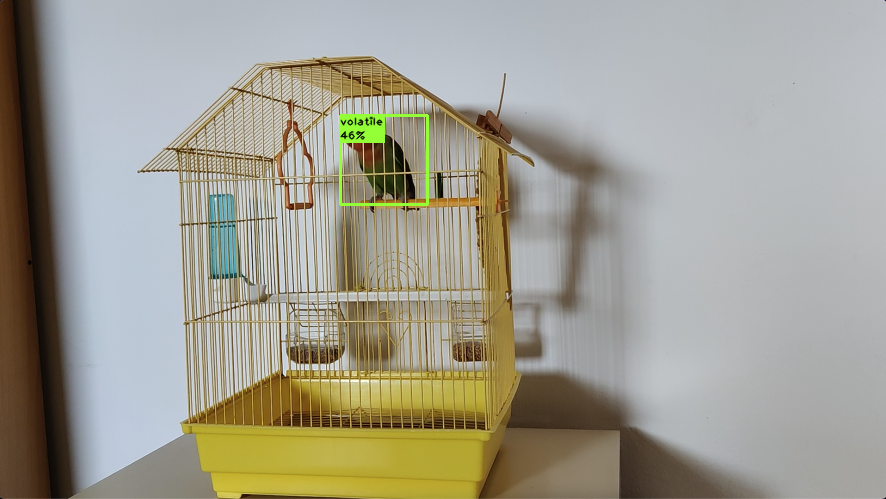

In [9]:
conf_threshold = 0.4
nms_threshold = 0.5
img = cv.imread("schermata.png")
img = cv.resize(img, None, fx = 0.5, fy = 0.5)
print(img.shape)
for i, c, r in zip(*yolo_detection_nms(img, conf_threshold, nms_threshold)):
    draw_object(img, i, c, r, True)
va.show(img)

""
""

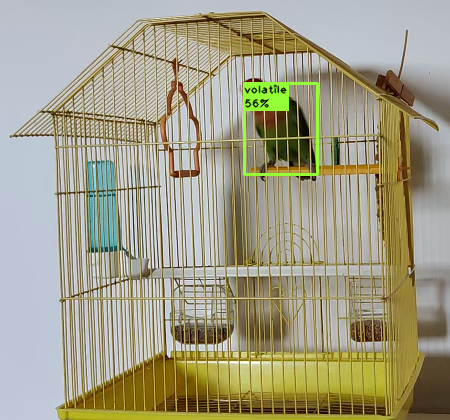

""
""

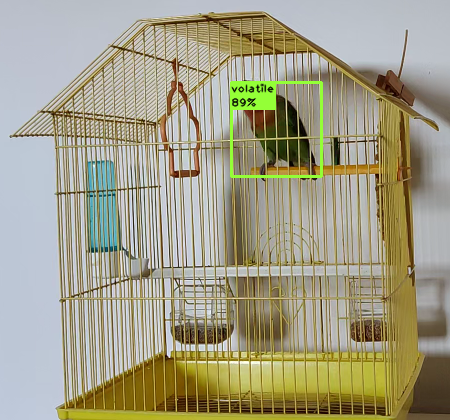

""
""

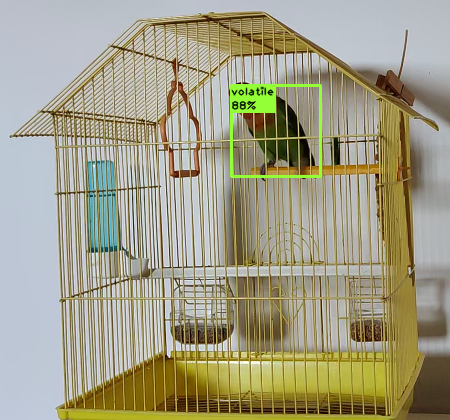

""
""

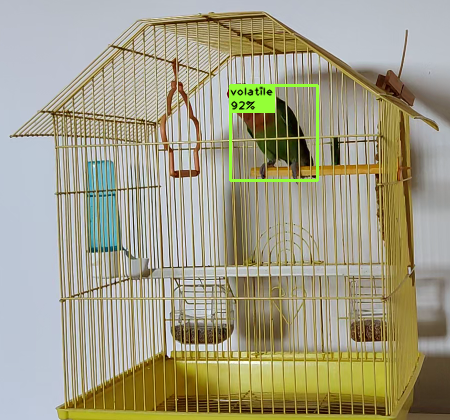

""
""

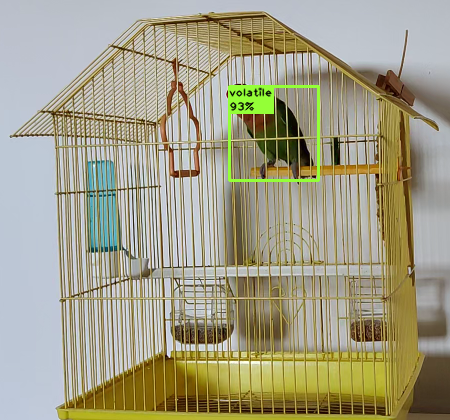

In [10]:
conf_threshold = 0.4
nms_threshold = 0.5
cap = cv.VideoCapture('VIDEO1.mp4')
for _ in range(5):
    img = cap.read()[1]
    img = cv.resize(img, None, fx = 0.5, fy = 0.5)
    img = img[50:470,140:590]
    for i, c, r in zip(*yolo_detection_nms(img, conf_threshold, nms_threshold)):
        draw_object(img, i, c, r, True)
    va.show(img)
cap.release()

In [90]:
coordinates = {'video1': {'minX': 50, 'maxX': 470, 'minY': 140, 'maxY': 590}, 
               'video2': {'minX': 20, 'maxX': 470, 'minY': 110, 'maxY': 550}, 
               'video3': {'minX': 50, 'maxX': 490, 'minY': 140, 'maxY': 590}, 
               'video4': {'minX': 0, 'maxX': 490, 'minY': 140, 'maxY': 600},
               'video5': {'minX': 30, 'maxX': 500, 'minY': 140, 'maxY': 600}, 
               'video6': {'minX': 60, 'maxX': 550, 'minY': 70, 'maxY': 510}, 
               'video7': {'minX': 60, 'maxX': 550, 'minY': 140, 'maxY': 530}, 
               'video8': {'minX': 60, 'maxX': 550, 'minY': 140, 'maxY': 530},
               'video9': {'minX': 60, 'maxX': 550, 'minY': 140, 'maxY': 530}, 
               'video10': {'minX': 30, 'maxX': 530, 'minY': 160, 'maxY': 570},
               'video11': {'minX': 30, 'maxX': 530, 'minY': 100, 'maxY': 510}, 
               'video12': {'minX': 30, 'maxX': 530, 'minY': 250, 'maxY': 680}, 
               'video13': {'minX': 30, 'maxX': 530, 'minY': 100, 'maxY': 500}, 
               'video14': {'minX': 30, 'maxX': 530, 'minY': 100, 'maxY': 500}, 
               'video15': {'minX': 30, 'maxX': 530, 'minY': 100, 'maxY': 550}, 
               'video16': {'minX': 30, 'maxX': 530, 'minY': 70, 'maxY': 500}, 
               'video17': {'minX': 30, 'maxX': 530, 'minY': 70, 'maxY': 500} }

#video6 = [60:550,70:510] (trova una sola volta)
#video7 = [60:550,140:530] (non lo trova quando è a mangiare)
#video8/9 = [60:550,140:530] (non lo trova quando è a mangiare)
#video10 = [30:530,160:570] (un frame è gatto)
#video11 = [30:530,100:510] (non lo trova, mangia)
#video16 = [30:530,70:500] non lo trova
#video17 = [30:530,70:500] non lo trova, dorme

""
""

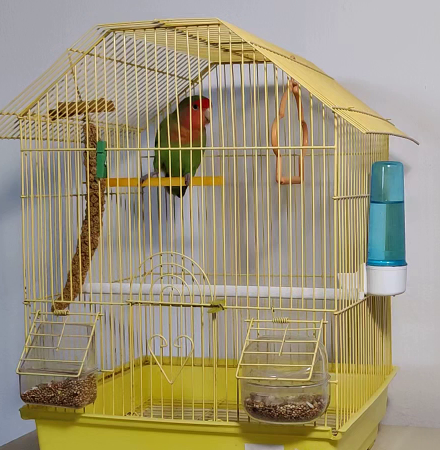

""
""

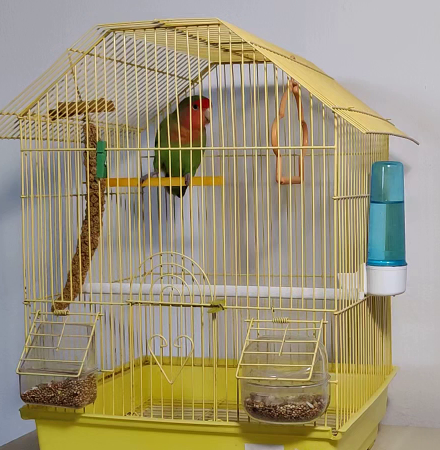

""
""

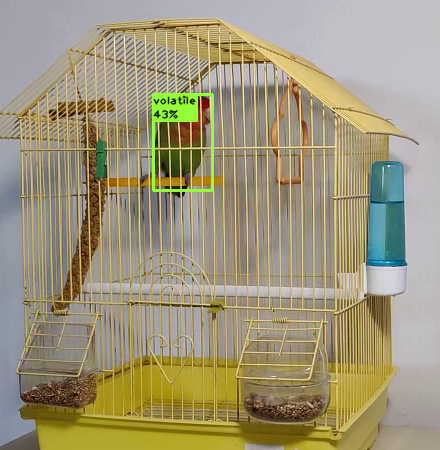

""
""

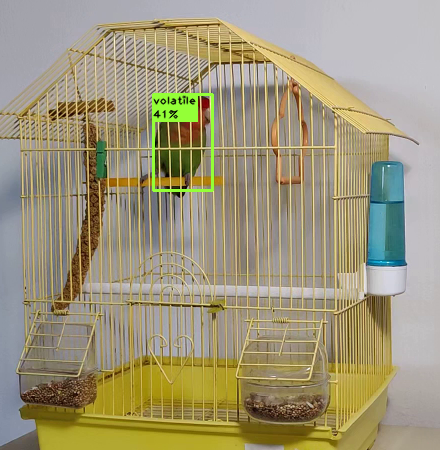

""
""

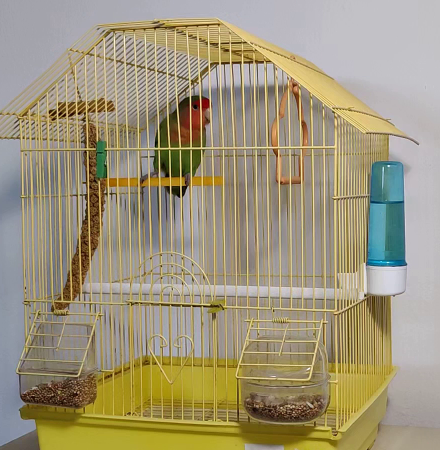

""
""

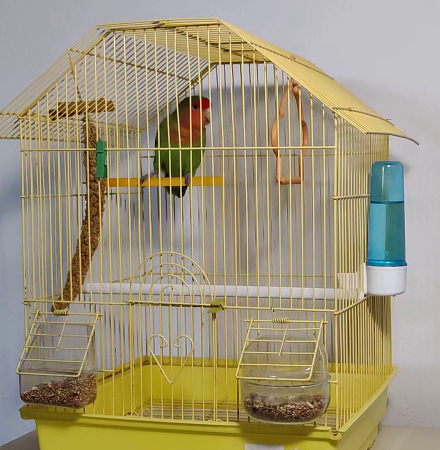

""
""

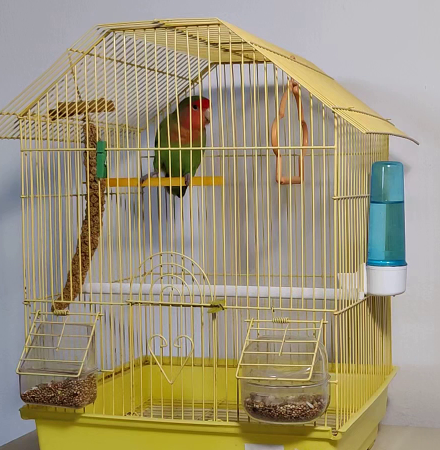

""
""

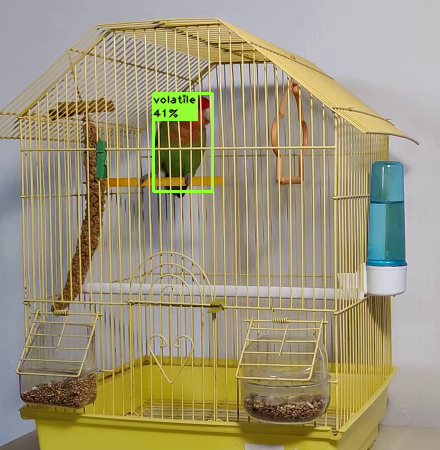

""
""

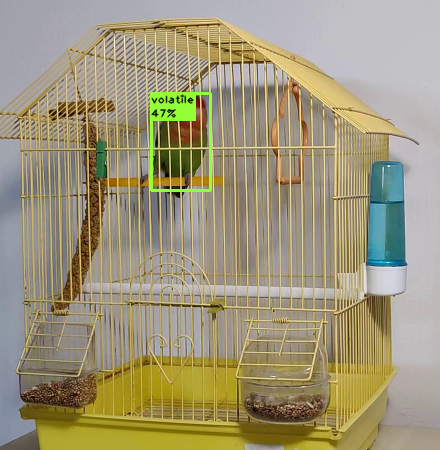

""
""

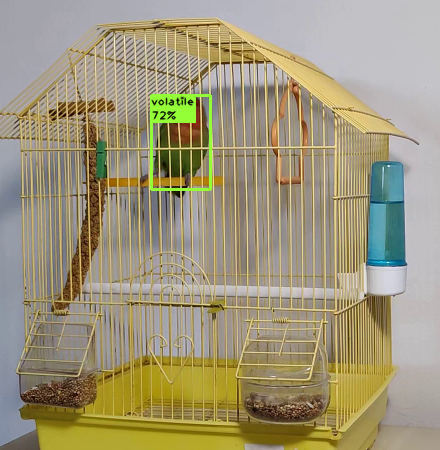

""
""

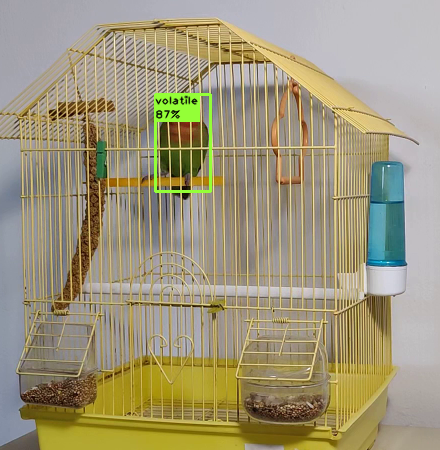

""
""

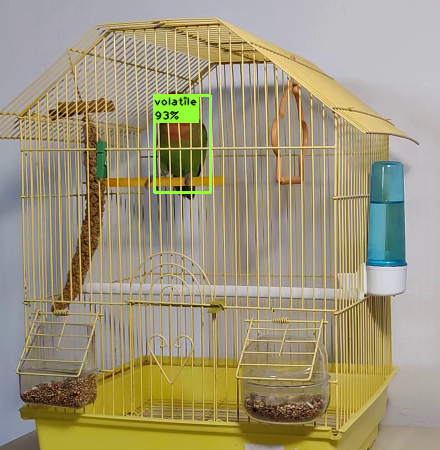

""
""

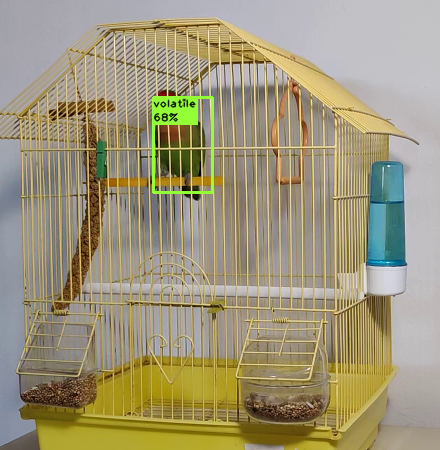

""
""

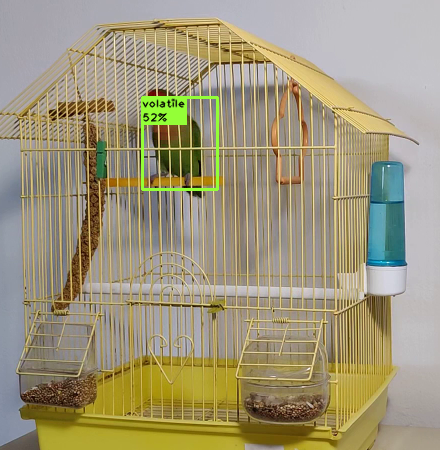

""
""

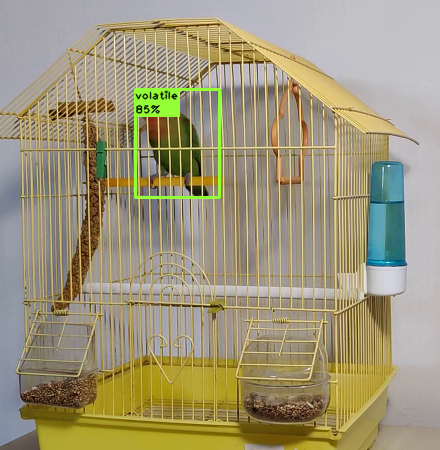

""
""

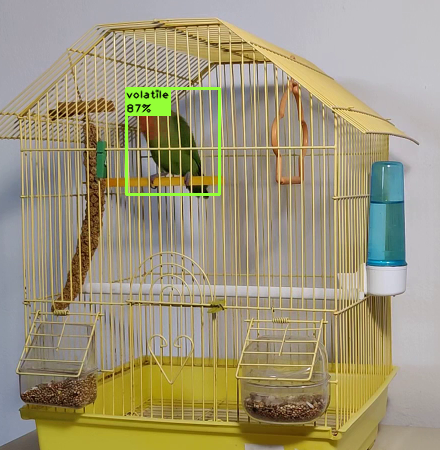

""
""

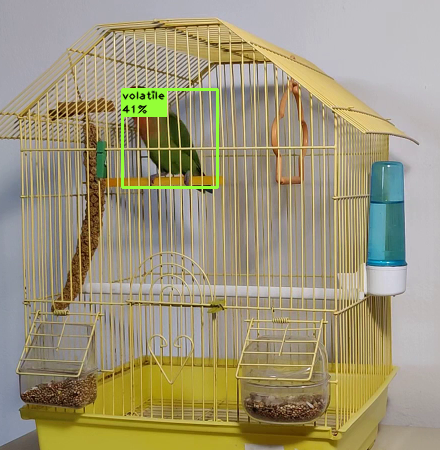

""
""

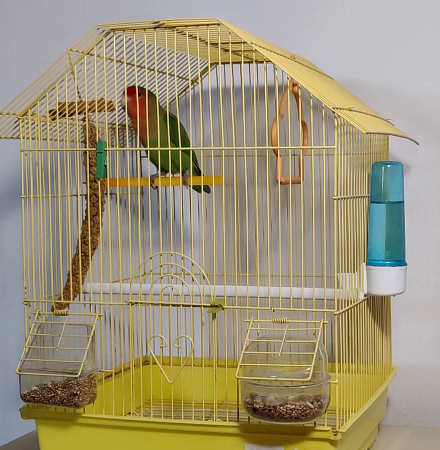

""
""

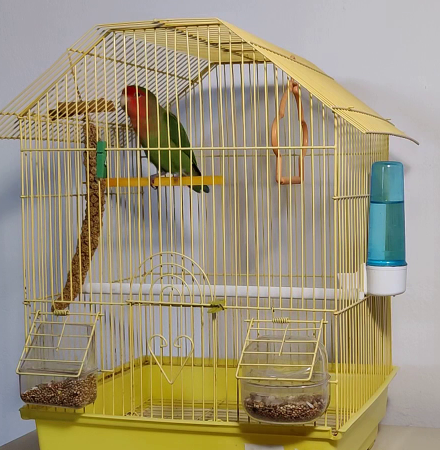

""
""

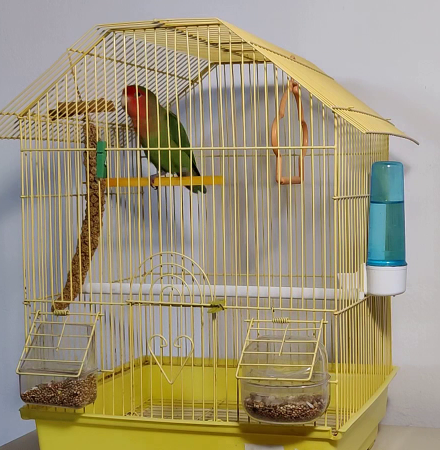

""
""

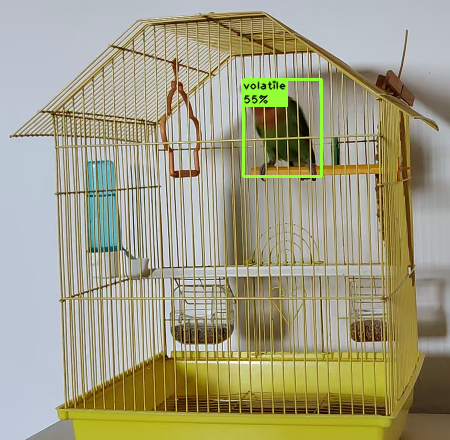

""
""

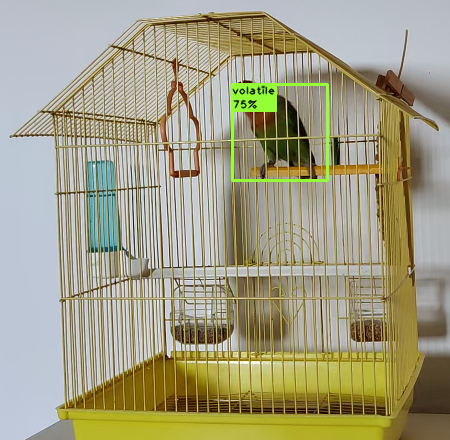

""
""

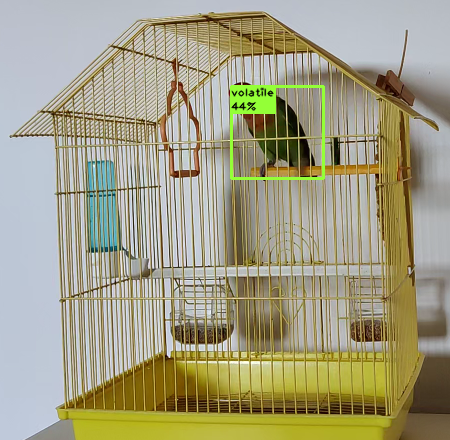

""
""

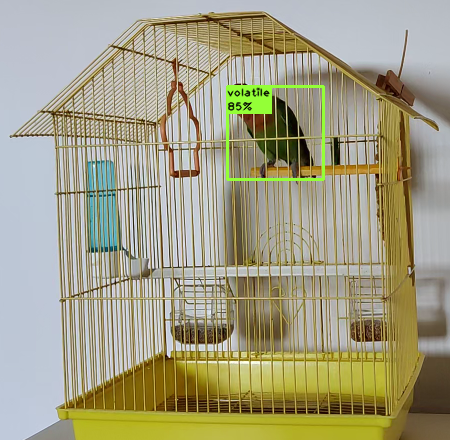

""
""

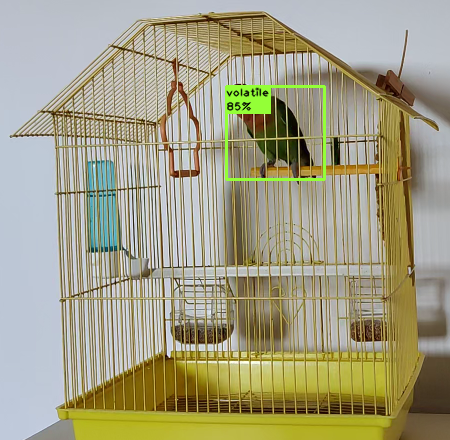

""
""

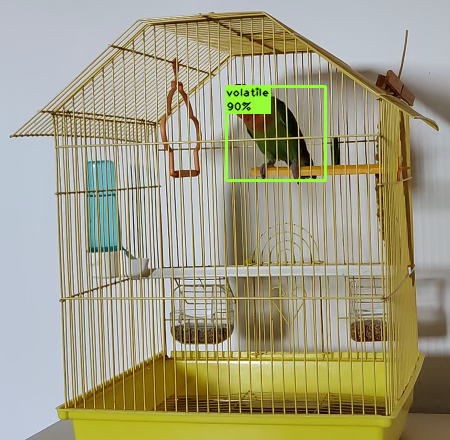

""
""

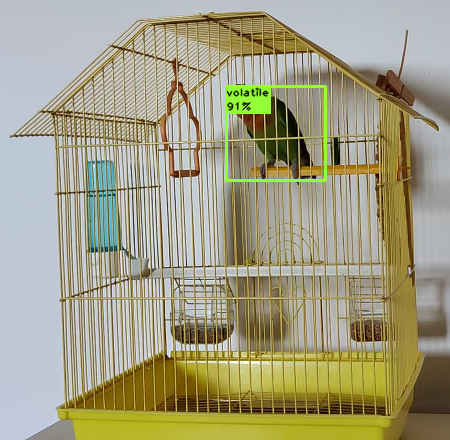

""
""

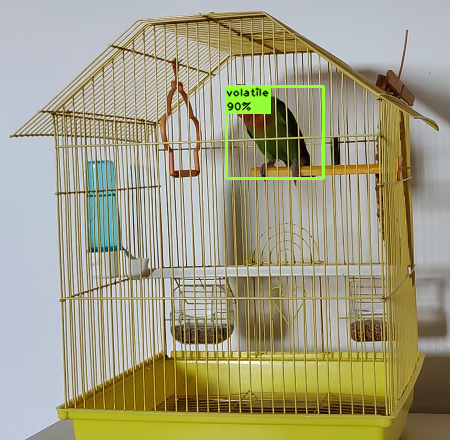

""
""

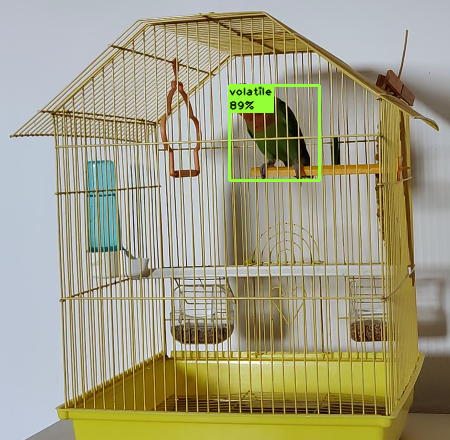

""
""

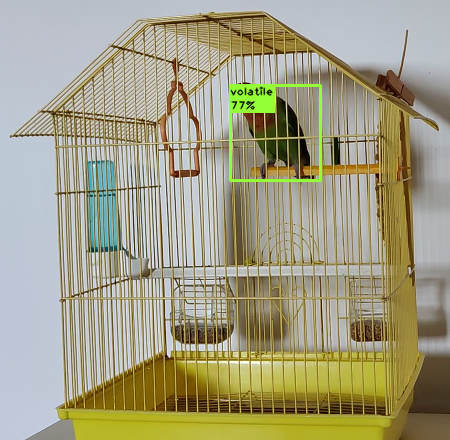

""
""

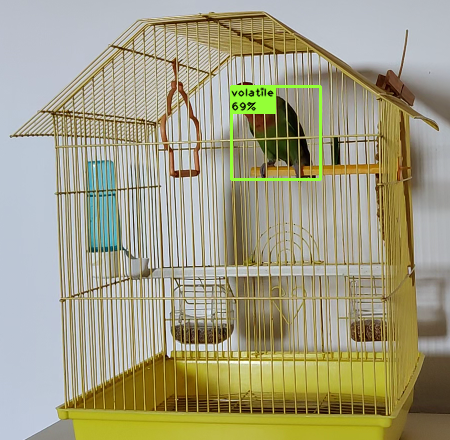

""
""

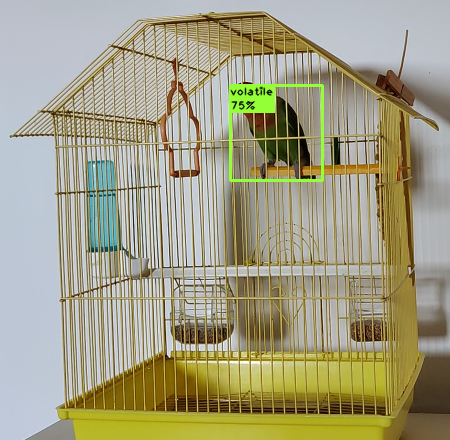

""
""

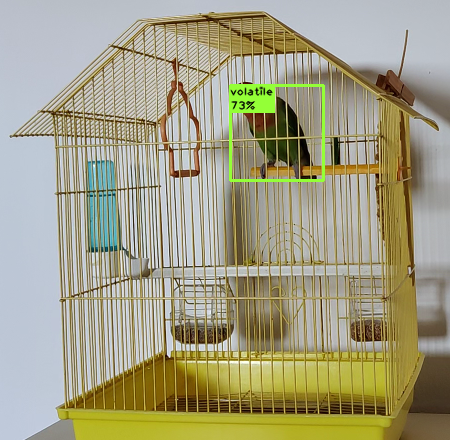

""
""

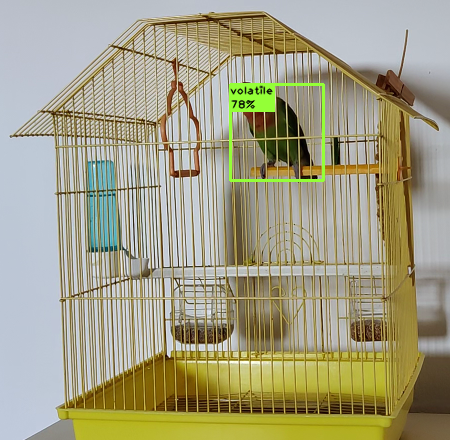

""
""

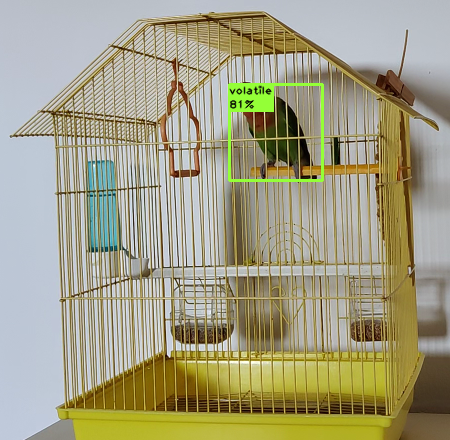

""
""

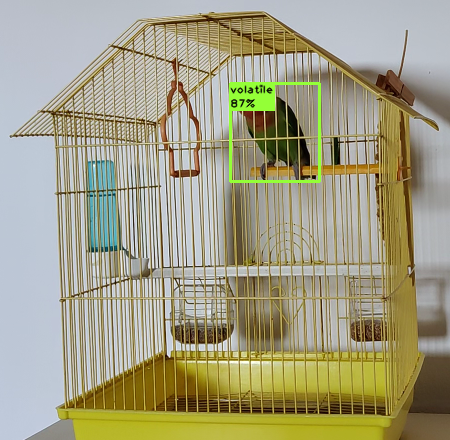

""
""

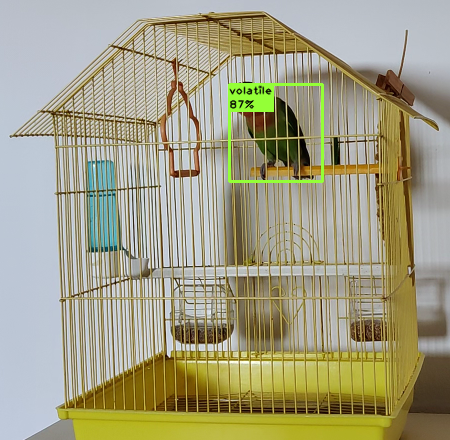

""
""

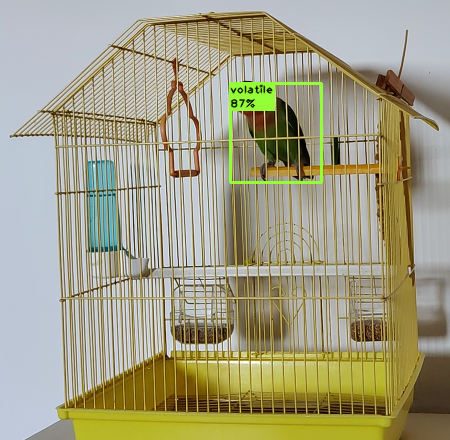

""
""

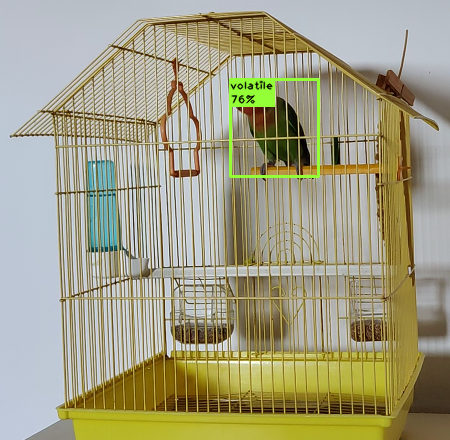

""
""

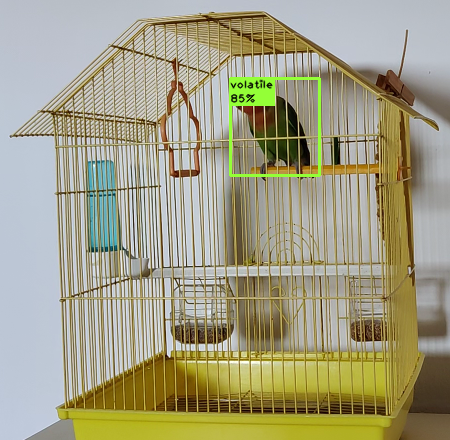

""
""

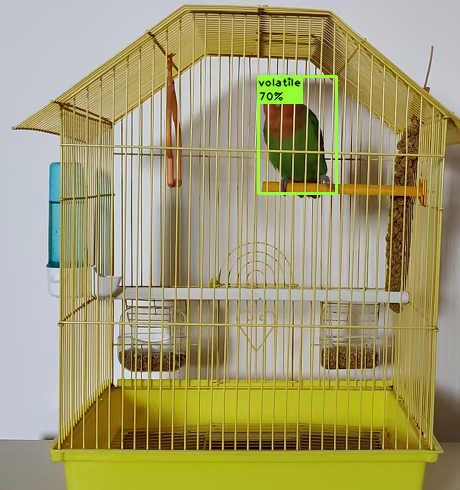

""
""

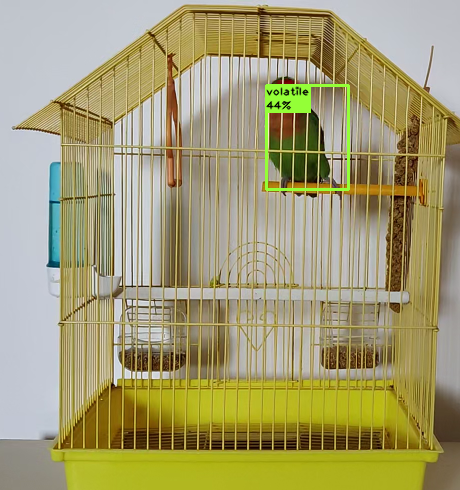

""
""

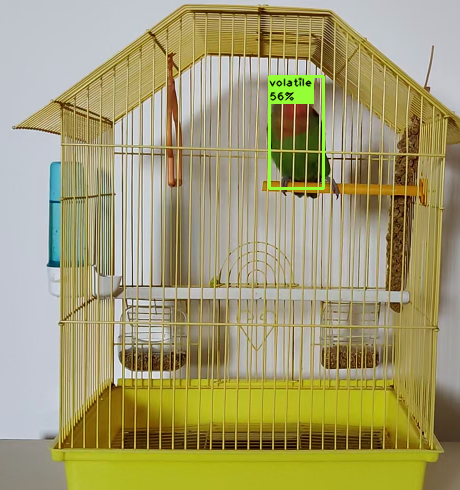

KeyboardInterrupt: 

In [91]:
conf_threshold = 0.4
nms_threshold = 0.5
for video, path in dataset.items():
    cap = cv.VideoCapture(path)
    for _ in range(20):
        img = cap.read()[1]
        img = cv.resize(img, None, fx = 0.5, fy = 0.5)
        coord = coordinates[video]
        img = img[coord['minX']:coord['maxX'],coord['minY']:coord['maxY']]
        for i, c, r in zip(*yolo_detection_nms(img, conf_threshold, nms_threshold)):
            draw_object(img, i, c, r, True)
        va.show(img)
    cap.release()